<a href="https://colab.research.google.com/github/sallypatteera/FYP_ctc_detection/blob/main/training/yolov5_training.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 1. Prepping


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
  !nvidia-smi

Mon Apr  7 07:58:45 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA L4                      Off |   00000000:00:03.0 Off |                    0 |
| N/A   46C    P8             17W /   72W |       3MiB /  23034MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [ ]:
# clone YOLOv5 repository
%cd /content
!git clone https://github.com/ultralytics/yolov5

/content
Cloning into 'yolov5'...
remote: Enumerating objects: 17360, done.
remote: Counting objects: 100% (52/52), done.
remote: Compressing objects: 100% (34/34), done.
remote: Total 17360 (delta 36), reused 18 (delta 18), pack-reused 17308 (from 2)
Receiving objects: 100% (17360/17360), 16.25 MiB | 14.37 MiB/s, done.
Resolving deltas: 100% (11901/11901), done.


In [ ]:
# install dependencies as necessary
!pip install -r requirements.txt
!pip uninstall wandb -qy  # deprecated dependency
import torch

from IPython.display import Image, clear_output  # to display images

# clear_output()
print('Setup complete. Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

Setup complete. Using torch 2.6.0+cu124 _CudaDeviceProperties(name='NVIDIA L4', major=8, minor=9, total_memory=22692MB, multi_processor_count=58, uuid=48129297-3d67-78b8-1fe4-42eec98349c2, L2_cache_size=48MB)


# 2. Prepare data

In [ ]:
# Download images from Roboflow (no augmentations and haven't splitted)
%cd /content/yolov5
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="spBAjpWMxKFY4zpIO74K")
project = rf.workspace("fyp-r71pm").project("cancer-cells-wt0tk")
version = project.version(50)
dataset = version.download("yolov5")

/content/yolov5
loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to cancer-cells-50 in yolov5pytorch:: 100%|██████████| 15870/15870 [00:04<00:00, 3399.29it/s]


In [ ]:
# check image classes
import yaml
import os
import shutil
import random

base = dataset.location
path = os.path.join(base, "data.yaml")
with open(path, 'r') as f:
  data = yaml.safe_load(f)

for i, class_name in enumerate(data['names']):
    print(f"Class {i}: {class_name}")

Class 0: cancer
Class 1: wbc


# Inspect unsplit data

In [ ]:
# Define paths
train_dir = os.path.join(base, "train")
train_image_folder = os.path.join(train_dir, "images")
train_label_folder = os.path.join(train_dir, "labels")

images = [f for f in os.listdir(train_image_folder) if f.endswith(('.jpg', '.png', '.jpeg'))]
labels = [f for f in os.listdir(train_label_folder) if f.endswith('.txt')]

In [ ]:
# print total number of images before splitting
print("🏋️‍♀️🏋️‍♀️🏋️‍♀️🏋️‍♀️🏋️‍♀️")
print(f"🔵total images: {len(images)} images")
print(f"🔵total labels: {len(labels)} images")

🏋️‍♀️🏋️‍♀️🏋️‍♀️🏋️‍♀️🏋️‍♀️
🔵total images: 6939 images
🔵total labels: 6939 images


In [ ]:
# check annotations
from collections import defaultdict

# Class names mapping
class_names = {
    0: "A549",
    1: "H2452",
    2: "HEYA8",
    3: "T24",
    4: "wbc"
}

# class_names = {
#     0: "cancer",
#     1: "wbc"
# }

# Dictionary to count annotations per class
class_counts = defaultdict(int)

# Function to count annotations in a given label directory
def count_annotations(label_dir):
    # Ensure the label directory exists
    if not os.path.exists(label_dir):
        print(f"Error: {label_dir} does not exist!")
        return defaultdict(int)  # Return empty dictionary in case of error

    # Count annotations in the directory
    class_counts = defaultdict(int)
    for label_file in os.listdir(label_dir):
        label_path = os.path.join(label_dir, label_file)
        with open(label_path, "r") as f:
            lines = f.readlines()

        # Count each class ID occurrence
        for line in lines:
            class_id = int(line.split()[0])  # Extract class ID (first value in YOLO format)
            if class_id in class_names:
                class_counts[class_id] += 1  # Increment count

    return class_counts

# Count all annotations before splitting
train_class_counts = count_annotations(train_label_folder)

print("\n🔹 Annotation Counts before splitting dataset:")
for class_id, count in sorted(train_class_counts.items()):
    print(f"📌 {class_names[class_id]} (Class {class_id}): {count} annotations")



🔹 Annotation Counts before splitting dataset:
📌 A549 (Class 0): 64718 annotations
📌 H2452 (Class 1): 11113 annotations


# Inspect splitted data

In [ ]:
# Define paths for validation and testing
val_image_dir = os.path.join(base, "valid/images")
val_label_dir = os.path.join(base, "valid/labels")

test_image_dir = os.path.join(base, "test/images")
test_label_dir = os.path.join(base, "test/labels")

# Create the necessary directories if they don't exist
os.makedirs(val_image_dir, exist_ok=True)
os.makedirs(val_label_dir, exist_ok=True)
os.makedirs(test_image_dir, exist_ok=True)
os.makedirs(test_label_dir, exist_ok=True)

In [ ]:
# print total number of images in each class
print("🏋️‍♀️🏋️‍♀️🏋️‍♀️🏋️‍♀️🏋️‍♀️")
print(f"🔵total images: {len(images)} images")
print(f"🔵total labels: {len(labels)} images")
print("----------------------------------")
print(f"total train images: {len(os.listdir(train_image_folder))} images")
print(f"total train labels: {len(os.listdir(train_label_folder))} images")
print("----------------------------------")
print(f"total val images: {len(os.listdir(val_image_dir))} images")
print(f"total val labels: {len(os.listdir(val_label_dir))} images")
print("----------------------------------")
print(f"total test images: {len(os.listdir(test_image_dir))} images")
print(f"total test labels: {len(os.listdir(test_label_dir))} images")

🏋️‍♀️🏋️‍♀️🏋️‍♀️🏋️‍♀️🏋️‍♀️
🔵total images: 6939 images
🔵total labels: 6939 images
----------------------------------
total train images: 6939 images
total train labels: 6939 images
----------------------------------
total val images: 661 images
total val labels: 661 images
----------------------------------
total test images: 329 images
total test labels: 329 images


In [ ]:
# Count annotations in the train, test, and validation sets
train_class_counts = count_annotations(train_label_folder)
test_class_counts = count_annotations(test_label_dir)
val_class_counts = count_annotations(val_label_dir)

# Print results for each set
print("\n🔹 Annotation Counts per Class in Training Set:")
for class_id, count in sorted(train_class_counts.items()):
    print(f"📌 {class_names[class_id]} (Class {class_id}): {count} annotations")

print("\n🔹 Annotation Counts per Class in Validation Set:")
for class_id, count in sorted(val_class_counts.items()):
    print(f"📌 {class_names[class_id]} (Class {class_id}): {count} annotations")

print("\n🔹 Annotation Counts per Class in Test Set:")
for class_id, count in sorted(test_class_counts.items()):
    print(f"📌 {class_names[class_id]} (Class {class_id}): {count} annotations")


🔹 Annotation Counts per Class in Training Set:
📌 A549 (Class 0): 64718 annotations
📌 H2452 (Class 1): 11113 annotations

🔹 Annotation Counts per Class in Validation Set:
📌 A549 (Class 0): 7107 annotations
📌 H2452 (Class 1): 1131 annotations

🔹 Annotation Counts per Class in Test Set:
📌 A549 (Class 0): 3447 annotations
📌 H2452 (Class 1): 568 annotations


# Modify hyperparameters yaml

In [ ]:
hyp_path = "/content/yolov5/data/hyps/hyp.scratch-high.yaml"

# read file
with open(hyp_path, 'r') as f:
  hyp = yaml.safe_load(f)

# modify hyperparameters in .yaml
hyp['lr0'] = 0.01
hyp['lrf'] = 0.1
hyp['momentum'] = 0.937
hyp['weight_decay'] = 0.0005
hyp['warmup_epochs'] = 3.0
hyp['warmup_momentum'] = 0.8
hyp['warmup_bias_lr'] = 0.1
hyp['box'] = 0.05
hyp['cls'] = 0.3
hyp['cls_pw'] = 1.0
hyp['obj'] = 0.7
hyp['obj_pw'] = 1.0
hyp['iou_t'] = 0.20
hyp['anchor_t'] = 4.0
hyp['fl_gamma'] = 0.0
hyp['hsv_h'] = 0.015
hyp['hsv_s'] = 0.7
hyp['hsv_v'] = 0.4
hyp['degrees'] = 0.0
hyp['translate'] = 0.1
hyp['scale'] = 0.9
hyp['shear'] = 0.0
hyp['perspective'] = 0.0
hyp['flipud'] = 0.5
hyp['fliplr'] = 0.5
hyp['mosaic'] = 1.0
hyp['mixup'] = 0.1
hyp['copy_paste'] = 0.1

"""
Additional augmentations that were applied in Roboflow:
Exposure: Between -5% and +5%
Blur: Up to 1.5px
Noise: Up to 1.01% of pixels
"""

# write the modified hyperparameters back
with open(hyp_path, 'w') as f:
  yaml.dump(hyp, f)

# Inspect class label

In [ ]:
# inspect class label
import os

# Check if the label folder exists
if not os.path.exists(train_label_folder):
    print("Error: Label folder does not exist!")

# List some label files
label_files = os.listdir(train_label_folder)
print(f"Found {len(label_files)} label files. Example files: {label_files[:5]}")

target_class = "0"  # Class ID as string

found_files = []
for label_file in label_files:
    label_path = os.path.join(train_label_folder, label_file)

    with open(label_path, "r") as f:
        lines = f.readlines()

    for line in lines:
        if line.startswith(target_class + " "):  # Check if class 1 is present
            found_files.append(label_file)
            break  # No need to check further

    if len(found_files) >= 5:  # Limit to 5 samples for quick checking
        break

print(f"Found {len(found_files)} label files containing class 1: {found_files}")

missing_images = []
for label_file in found_files:
    image_file = label_file.replace(".txt", ".jpg")  # Change extension if needed
    image_path = os.path.join(train_image_folder, image_file)

    if not os.path.exists(image_path):
        missing_images.append(image_file)

print(f"Missing images: {missing_images}")


Found 6939 label files. Example files: ['tile_x012_y010_jpg.rf.102348408aae388712d9011e0d2dc0d0.txt', 'tile_x005_y006_jpg.rf.d564a75c8fce5914c29f76a491673ac4.txt', 'tile_x016_y008_jpg.rf.76451422f576b7afc7566a9e953cd4f7.txt', 'tile_x009_y016_jpg.rf.78d38f25acb16ef7dc82b94f0fb389d5.txt', 'tile_x008_y006_jpg.rf.18c40919ca0d2a7bee15a9e5273238dc.txt']
Found 5 label files containing class 1: ['tile_x012_y010_jpg.rf.102348408aae388712d9011e0d2dc0d0.txt', 'tile_x005_y006_jpg.rf.d564a75c8fce5914c29f76a491673ac4.txt', 'tile_x016_y008_jpg.rf.76451422f576b7afc7566a9e953cd4f7.txt', 'tile_x009_y016_jpg.rf.78d38f25acb16ef7dc82b94f0fb389d5.txt', 'tile_x008_y006_jpg.rf.18c40919ca0d2a7bee15a9e5273238dc.txt']
Missing images: []


# Visualize Train, Val and Test data before training


📄 Label File: tile_x012_y010_jpg.rf.102348408aae388712d9011e0d2dc0d0.txt
1 0.3219579668959629 0.9350857265962682 0.0598515454840256 0.07796156563654523
1 0.4857493392674453 0.9277083204344905 0.03536362381650371 0.05671823839664894
0 0.3217124059023567 0.935474500794457 0.05936042349681325 0.0771840172401673
0 0.5479682690586843 0.9318038168691543 0.06215375561061909 0.042172599315714966
0 0.8172164219890347 0.6026520102997046 0.07415942006906939 0.11740980785302524
0 0.3219775711146965 0.48813778521944595 0.06091333010039701 0.10008977043811747
0 0.8045929417956679 0.2695586495156447 0.058940319939910335 0.09477531528023365
0 0.2796280572182191 0.8998668970370387 0.0756299452934942 0.11900769918470062
0 0.05447363083274783 0.36615072330983606 0.061427177985308515 0.10674534969415725
0 0.4769691245296119 0.799939491618862 0.058968727312034175 0.102122853854811
0 0.8580107950369984 0.5300332009683242 0.0844928669610161 0.13888160117916026
🖼 Displaying: tile_x012_y010_jpg.rf.102348408aa

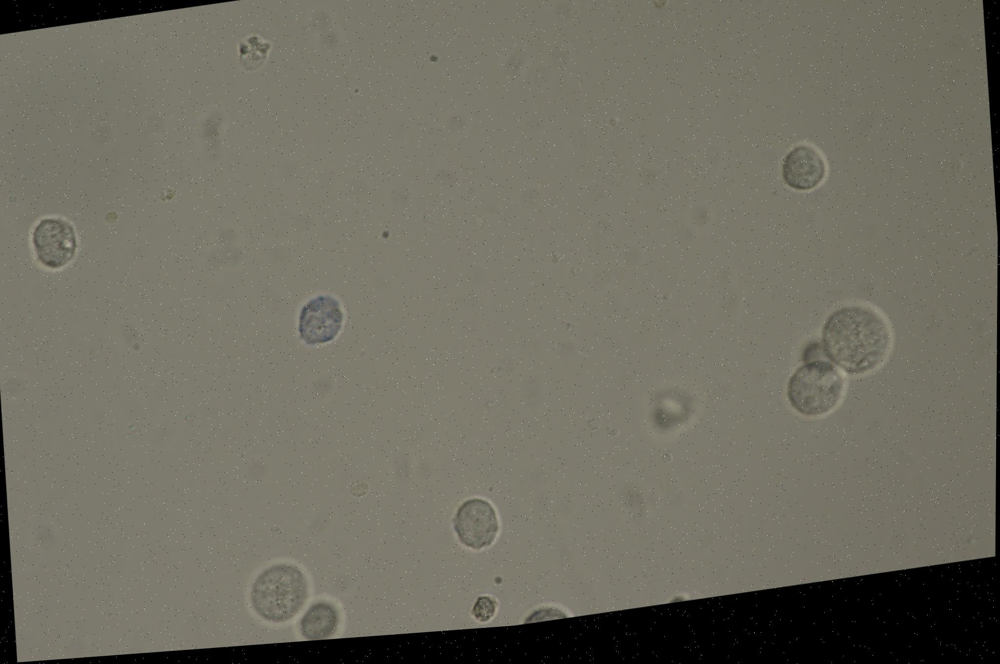


📄 Label File: tile_x005_y006_jpg.rf.d564a75c8fce5914c29f76a491673ac4.txt
0 0.8023943674162823 0.8996396926131429 0.06569706792548269 0.0999967739612704
0 0.9013577428538949 0.6640542580703394 0.06964308959261323 0.1052768636503553
0 0.8372506863910543 0.7162492773322057 0.07508236334340879 0.11428202738430897
0 0.7905685209709408 0.7560811285767155 0.06619103084221556 0.10074862940458827
0 0.5782890841571879 0.08478732078641449 0.061745364591618834 0.09398193041472781
0 0.829375345967958 0.7877769252935086 0.0745827187599426 0.11279541808353336
0 0.8431205695019356 0.8725038759757358 0.05631745417428946 0.08644627439568957
0 0.5966397447883525 0.02695558576092707 0.07722832292329507 0.05391117152185414
0 0.8706401090816231 0.911940547741888 0.07212426750974377 0.11050564858185982
0 0.7753489049197622 0.8620228039047749 0.058781587091221166 0.08947079775482085
0 0.9116535774263244 0.7845279311473579 0.08644351042826637 0.1315747025806187
0 0.9261178738910543 0.7131367887056728 0.067178

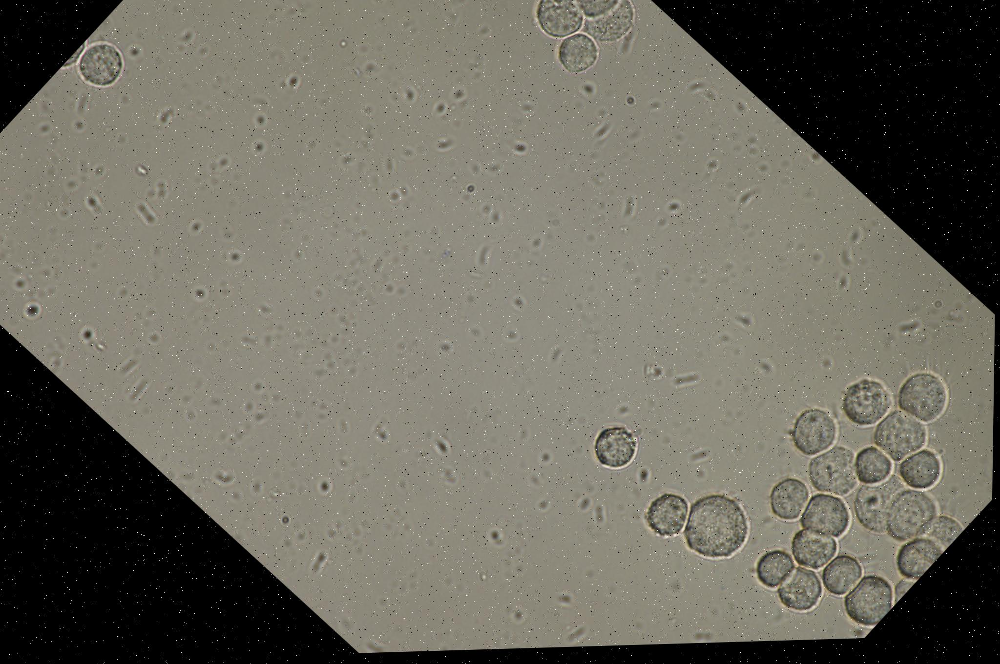


📄 Label File: tile_x016_y008_jpg.rf.76451422f576b7afc7566a9e953cd4f7.txt
0 0.8776763680783413 0.41406051594999305 0.0660672551157302 0.08807387532477322
0 0.005854785601670642 0.41107063635507274 0.011709571203341283 0.11971658498053495
0 0.3352208609755175 0.39816836513061066 0.06601741240759906 0.09612194604589896
0 0.07739290046988472 0.1499834446154167 0.06650569365759904 0.09615616775680849
🖼 Displaying: tile_x016_y008_jpg.rf.76451422f576b7afc7566a9e953cd4f7.jpg


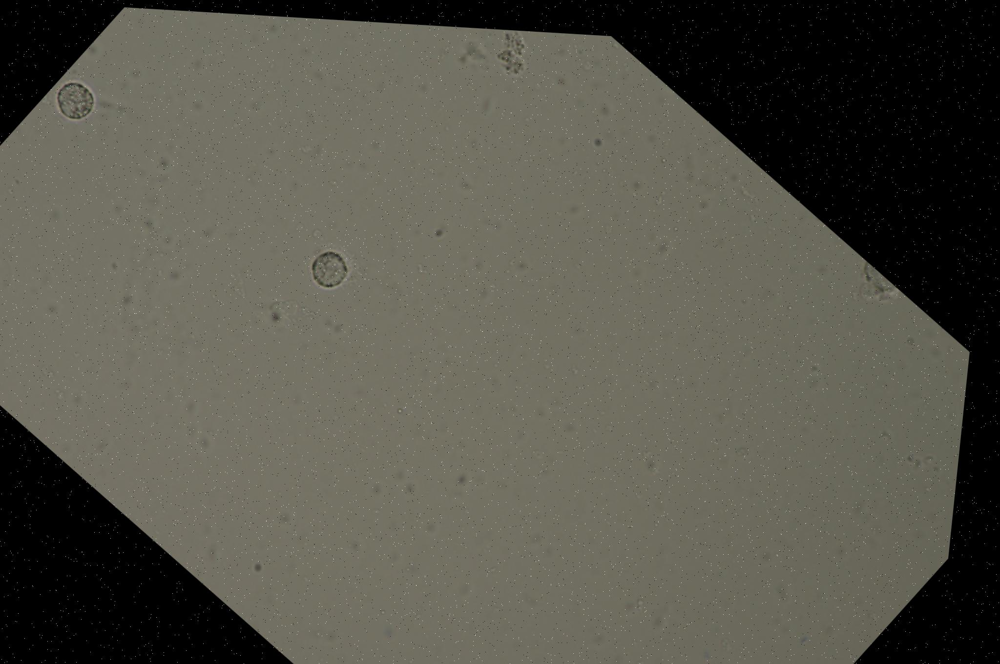


📄 Label File: tile_x009_y016_jpg.rf.78d38f25acb16ef7dc82b94f0fb389d5.txt
0 0.031828929201980924 0.785161844374177 0.046407345017871804 0.08875052139124921
0 0.11707662223159082 0.783611271166984 0.06806217963631145 0.10476291126107591
0 0.4661336669245332 0.9041172201845608 0.07105152800276526 0.11008582181609916
0 0.9459922949204591 0.2533861324766257 0.08446524223765861 0.13073252695514315
0 0.3785447521789683 0.5142766391308868 0.08644393618042479 0.1330565442293957
0 0.08481967481407351 0.7197818616173179 0.08296630656397086 0.12770369474890272
0 0.07147222757339919 0.8117745382434386 0.09292796012517646 0.14520181197982707
0 0.16625635970283426 0.41075176852679085 0.06856750684815538 0.10626235790146114
🖼 Displaying: tile_x009_y016_jpg.rf.78d38f25acb16ef7dc82b94f0fb389d5.jpg


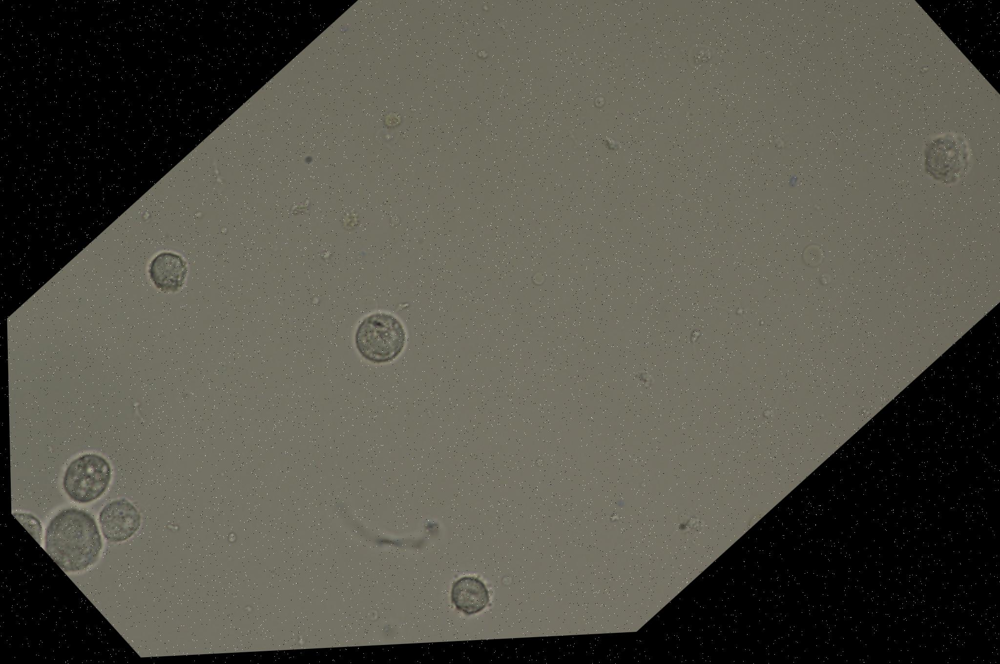


📄 Label File: tile_x008_y006_jpg.rf.18c40919ca0d2a7bee15a9e5273238dc.txt
0 0.74462890625 0.5451873622336517 0.046875 0.07200587803085966
🖼 Displaying: tile_x008_y006_jpg.rf.18c40919ca0d2a7bee15a9e5273238dc.jpg


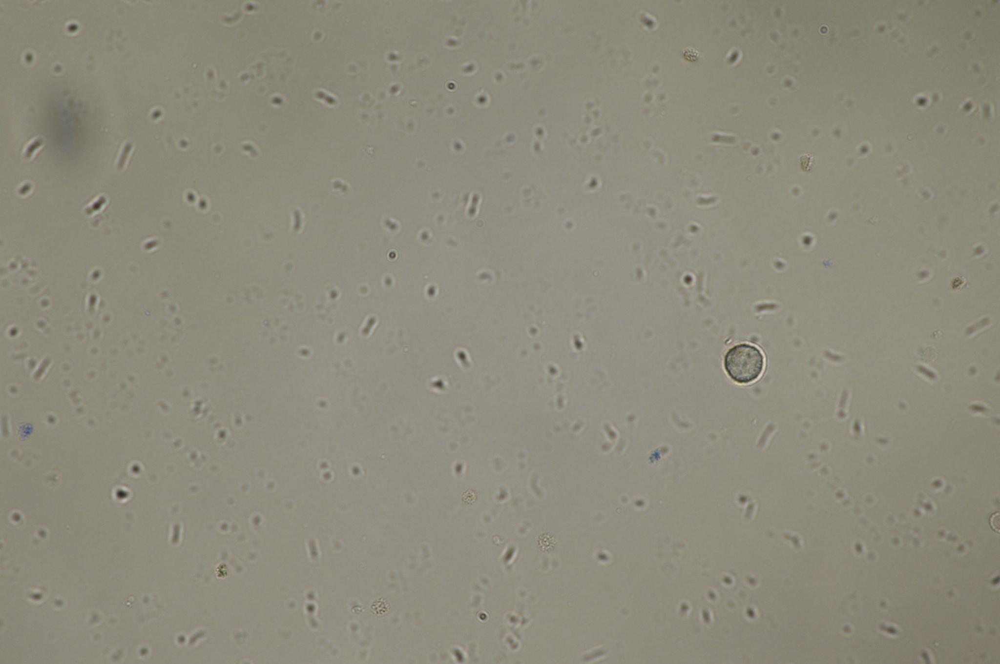

In [ ]:
import os
from IPython.display import display
from PIL import Image

# Display images along with label contents
for label_file in found_files:
    image_file = label_file.replace(".txt", ".jpg")  # Modify extension if needed
    image_path = os.path.join(train_image_folder, image_file)
    label_path = os.path.join(train_label_folder, label_file)

    if os.path.exists(image_path):
        # Print the label file content
        print(f"\n📄 Label File: {label_file}")
        with open(label_path, "r") as f:
            label_contents = f.readlines()
            for line in label_contents:
                print(line.strip())  # Print each line in the label file

        # Display the corresponding image
        print(f"🖼 Displaying: {image_file}")
        img = Image.open(image_path)
        display(img)  # Show image in Colab
    else:
        print(f"⚠️ Image not found: {image_file}")


In [ ]:
# Display images along with label contents
for label_file in found_files:
    image_file = label_file.replace(".txt", ".jpg")  # Modify extension if needed
    image_path = os.path.join(train_image_folder, image_file)
    label_path = os.path.join(train_label_folder, label_file)

    if os.path.exists(image_path):
        # Print the label file content
        print(f"\n📄 Label File: {label_file}")
        with open(label_path, "r") as f:
            label_contents = f.readlines()
            for line in label_contents:
                print(line.strip())  # Print each line in the label file

        # Display the corresponding image
        print(f"🖼 Displaying: {image_file}")
        img = Image.open(image_path)
        display(img)  # Show image in Colab
    else:
        print(f"⚠️ Image not found: {image_file}")

# Train Custom YOLOv5 Detector


Here, we are able to pass a number of arguments:
- **img:** define input image size
- **batch:** determine batch size
- **epochs:** define the number of training epochs. (Note: often, 3000+ are common here!)
- **data:** set the path to our yaml file
- **cfg:** specify our model configuration
- **weights:** specify a custom path to weights. (Note: you can download weights from the Ultralytics Google Drive [folder](https://drive.google.com/open?id=1Drs_Aiu7xx6S-ix95f9kNsA6ueKRpN2J))
- **name:** result names
- **cache:** cache images for faster training

In [ ]:
# run tensorboard in parallel
%cd /content/yolov5/
%reload_ext tensorboard
%tensorboard --logdir runs/train

/content/yolov5


Reusing TensorBoard on port 6006 (pid 4369), started 7:28:08 ago. (Use '!kill 4369' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
# training
%%time
%cd /content/yolov5/
!python train.py \
  --img 640 \
  --batch 16 \
  --epochs 200 \
  --cos-lr \
  --data {dataset.location}/data.yaml \
  --hyp hyp.scratch-high.yaml \
  --weights yolov5s.pt \
  --name yolov5s_results  \
  --cache \
  --patience 20

Streaming output truncated to the last 5000 lines.
  with torch.cuda.amp.autocast(amp):
    184/199      4.15G    0.02657    0.03449   0.001323        336        640:  29% 127/434 [00:17<00:42,  7.26it/s]/content/yolov5/train.py:412: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(amp):
    184/199      4.15G    0.02657    0.03454   0.001326        355        640:  29% 128/434 [00:17<00:41,  7.36it/s]/content/yolov5/train.py:412: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(amp):
    184/199      4.15G    0.02657     0.0346   0.001325        431        640:  30% 129/434 [00:17<00:40,  7.45it/s]/content/yolov5/train.py:412: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(

# Evaluate Custom YOLOv5 Detector Performance

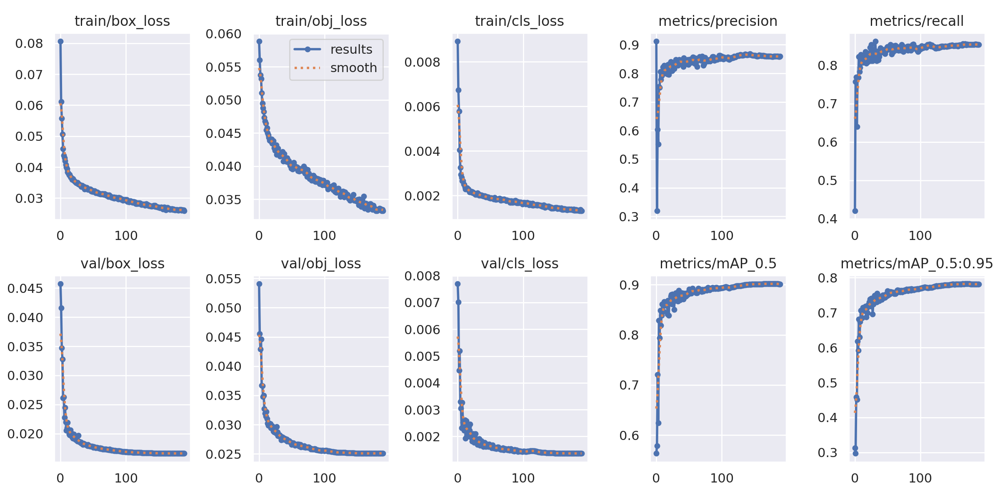

In [ ]:
from utils.plots import plot_results
Image(filename='/content/yolov5/runs/train/yolov5s_results2/results.png', width=1000)

In [ ]:
%cd /content/yolov5/
!python val.py --weights runs/train/yolov5s_results2/weights/best.pt --data {dataset.location}/data.yaml --img 640 --batch 16

/content/yolov5
val: data=/content/yolov5/cancer-cells-50/data.yaml, weights=['runs/train/yolov5s_results2/weights/best.pt'], batch_size=16, imgsz=640, conf_thres=0.001, iou_thres=0.6, max_det=300, task=val, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v7.0-411-gf4d8a84c Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (NVIDIA L4, 22693MiB)

Fusing layers... 
Model summary: 157 layers, 7015519 parameters, 0 gradients, 15.8 GFLOPs
val: Scanning /content/yolov5/cancer-cells-50/valid/labels.cache... 661 images, 1 backgrounds, 0 corrupt: 100% 661/661 [00:00<?, ?it/s]
                 Class     Images  Instances          P          R      mAP50   mAP50-95: 100% 42/42 [00:09<00:00,  4.42it/s]
                   all        661       8238      0.859      0.855      0.902      0.783
                cancer        661       7107      0.942  

#Visualize Our Training Data with Labels

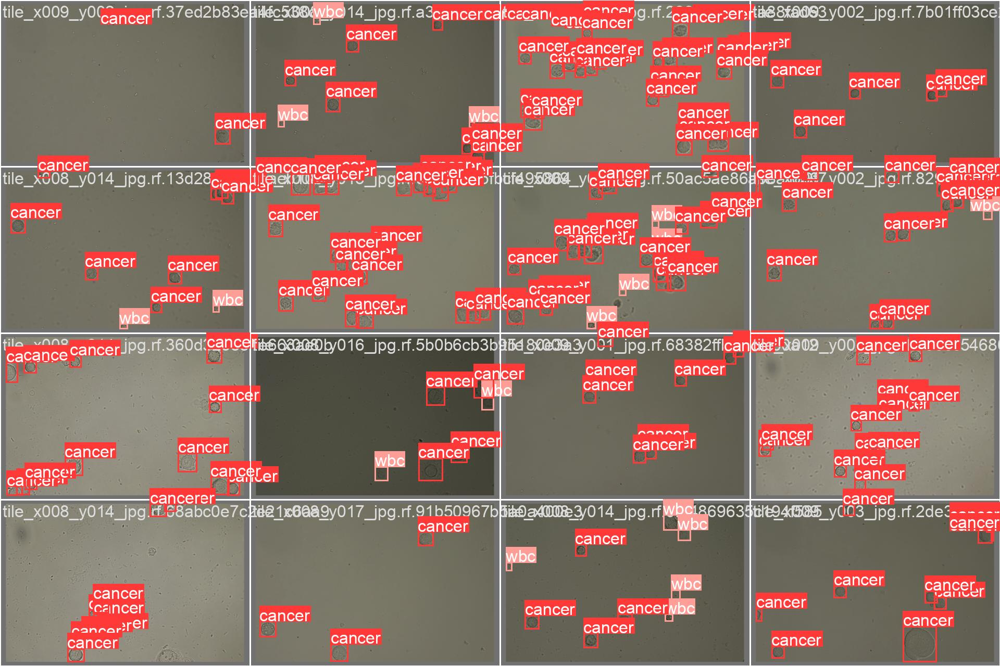

In [ ]:
Image(filename='/content/yolov5/runs/train/yolov5s_results2/val_batch0_labels.jpg', width=1500)

GROUND TRUTH AUGMENTED TRAINING DATA:


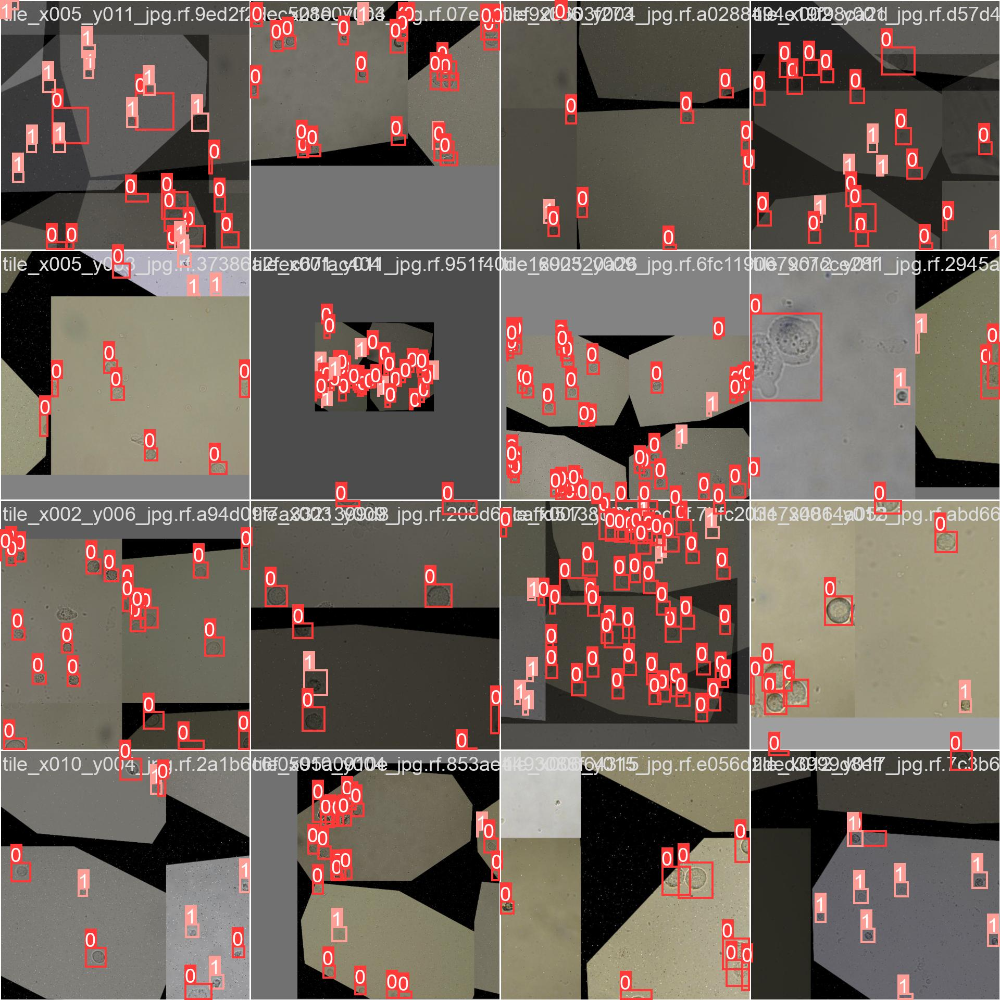

In [ ]:
# print out an augmented training example
print("GROUND TRUTH AUGMENTED TRAINING DATA:")
Image(filename='/content/yolov5/runs/train/yolov5s_results2/train_batch0.jpg', width=1500)

In [ ]:
%cd /content/drive/MyDrive/

/content/drive/MyDrive


In [ ]:
!zip -r yolov5s_results_0407_2.zip /content/yolov5/runs/train/yolov5s_results2

  adding: content/yolov5/runs/train/yolov5s_results2/ (stored 0%)
  adding: content/yolov5/runs/train/yolov5s_results2/hyp.yaml (deflated 44%)
  adding: content/yolov5/runs/train/yolov5s_results2/opt.yaml (deflated 49%)
  adding: content/yolov5/runs/train/yolov5s_results2/train_batch0.jpg (deflated 7%)
  adding: content/yolov5/runs/train/yolov5s_results2/P_curve.png (deflated 13%)
  adding: content/yolov5/runs/train/yolov5s_results2/val_batch2_labels.jpg (deflated 9%)
  adding: content/yolov5/runs/train/yolov5s_results2/val_batch1_pred.jpg (deflated 8%)
  adding: content/yolov5/runs/train/yolov5s_results2/train_batch2.jpg (deflated 9%)
  adding: content/yolov5/runs/train/yolov5s_results2/val_batch0_pred.jpg (deflated 8%)
  adding: content/yolov5/runs/train/yolov5s_results2/weights/ (stored 0%)
  adding: content/yolov5/runs/train/yolov5s_results2/weights/best.pt (deflated 9%)
  adding: content/yolov5/runs/train/yolov5s_results2/weights/last.pt (deflated 9%)
  adding: content/yolov5/runs

In [ ]:
# save to device
from google.colab import files
files.download("yolov5s_results_0407_2.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# Run Inference With Trained Weights

Next, we can run inference with a pretrained checkpoint on all images in the `test/images` folder to understand how our model performs on our test set.

In [ ]:
# trained weights are saved by default in our weights folder
%ls runs/

ls: cannot access 'runs/': No such file or directory


In [ ]:
%ls content/yolov5/runs/train/yolov5s_results2/weights

ls: cannot access 'content/yolov5/runs/train/yolov5s_results2/weights': No such file or directory


In [ ]:
%cd /content/yolov5/
!python detect.py --weights runs/train/yolov5s_results2/weights/best.pt --img 640 --conf 0.4 --source {dataset.location}/test/images/ --iou-thres 0.3 --save-conf --save-txt

/content/yolov5
detect: weights=['runs/train/yolov5s_results2/weights/best.pt'], source=/content/yolov5/cancer-cells-50/test/images/, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.4, iou_thres=0.3, max_det=1000, device=, view_img=False, save_txt=True, save_format=0, save_csv=False, save_conf=True, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-411-gf4d8a84c Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (NVIDIA L4, 22693MiB)

Fusing layers... 
Model summary: 157 layers, 7015519 parameters, 0 gradients, 15.8 GFLOPs
image 1/329 /content/yolov5/cancer-cells-50/test/images/left_tile_x002_y013_jpg.rf.d4e428a7a7fc937a01d5a4ae2ab40931.jpg: 640x640 2 cancers, 2 wbcs, 6.5ms
image 2/329 /content/yolov5/cancer-cells-50/test/images/left_tile_x003_y001_jpg.rf.71652a76cf7cbc43445c81c77f

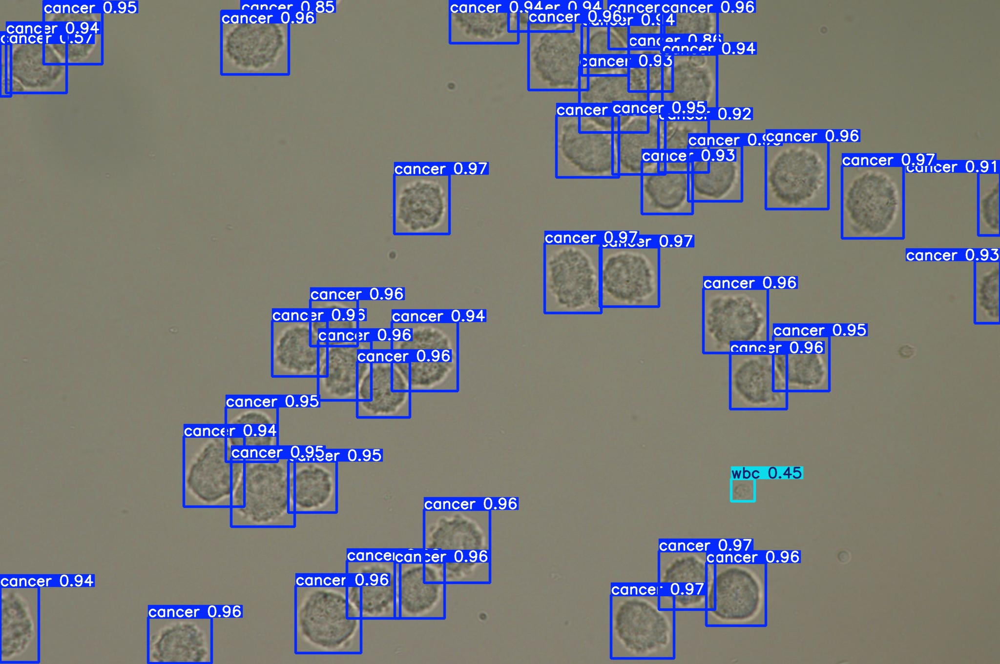

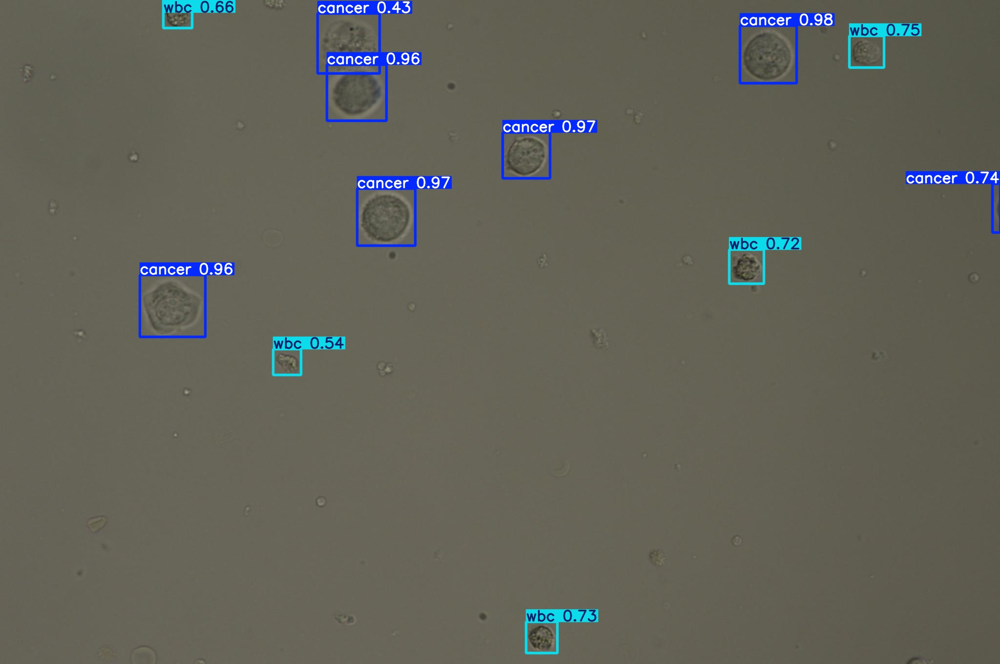

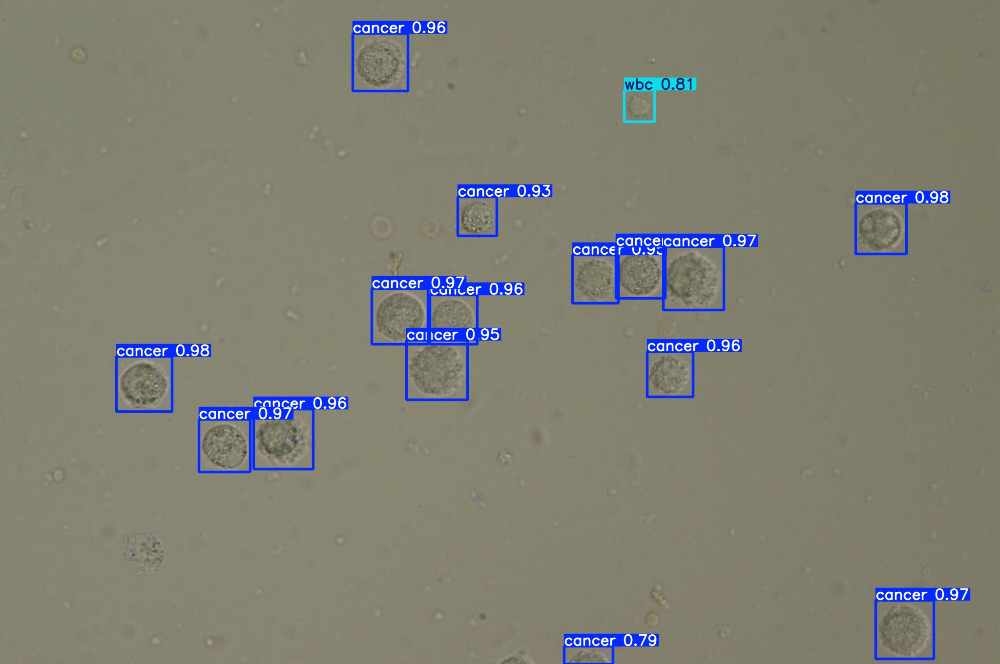

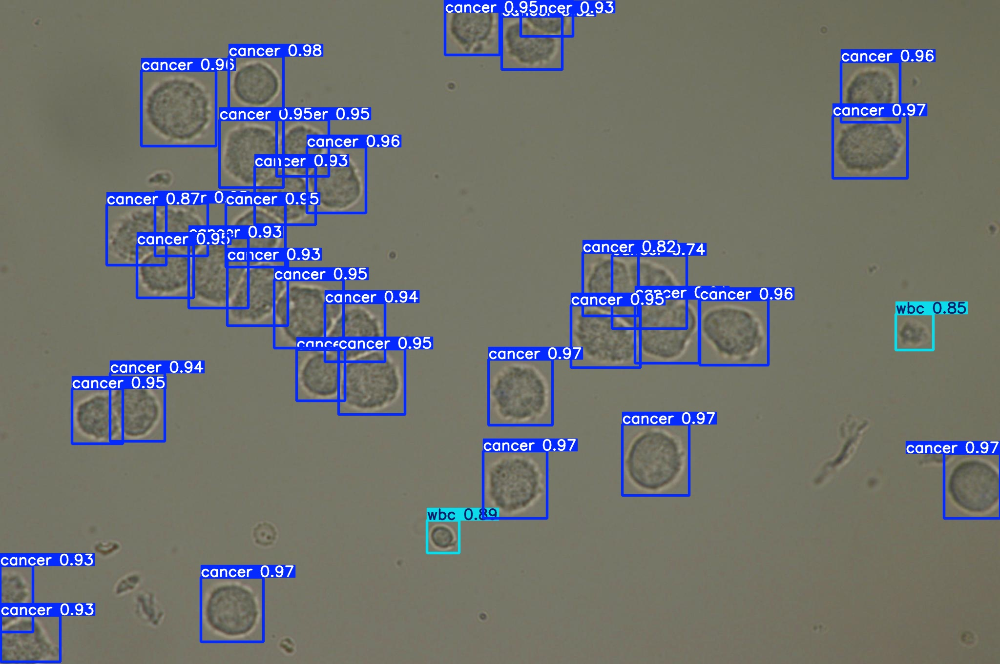

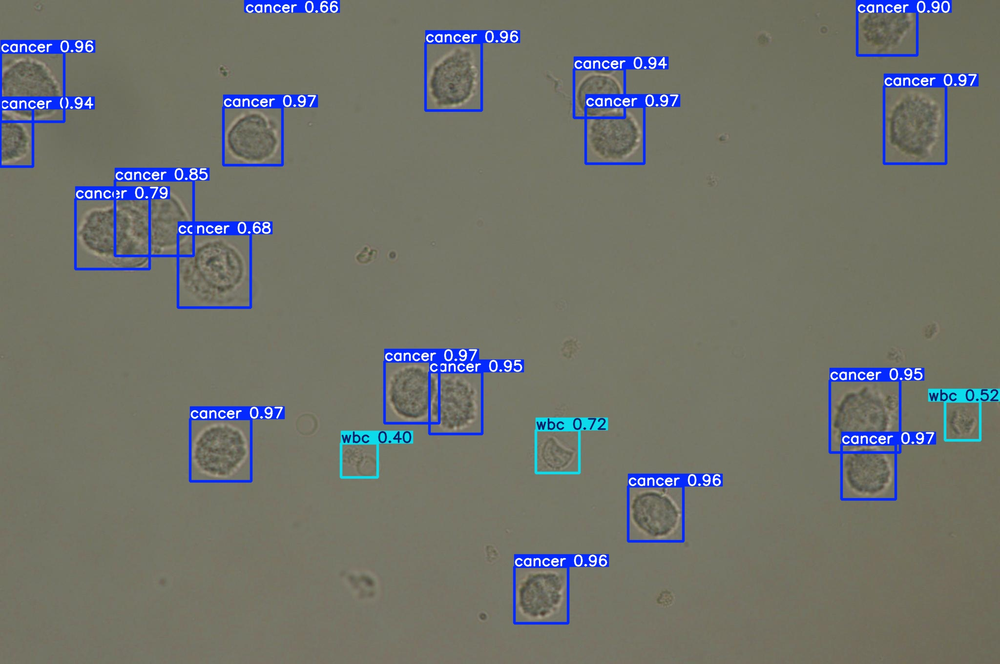

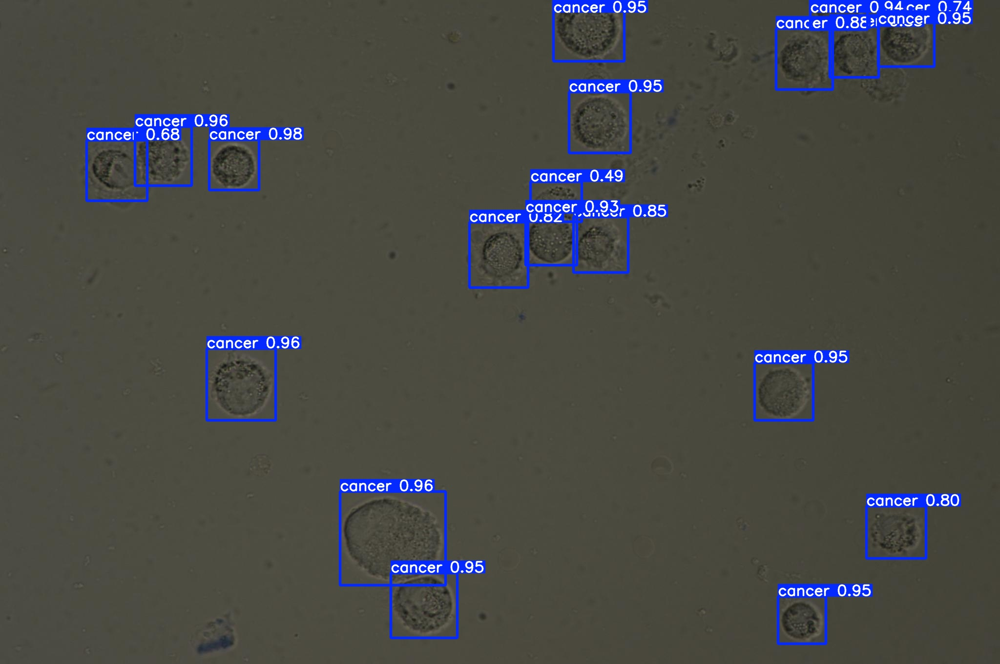

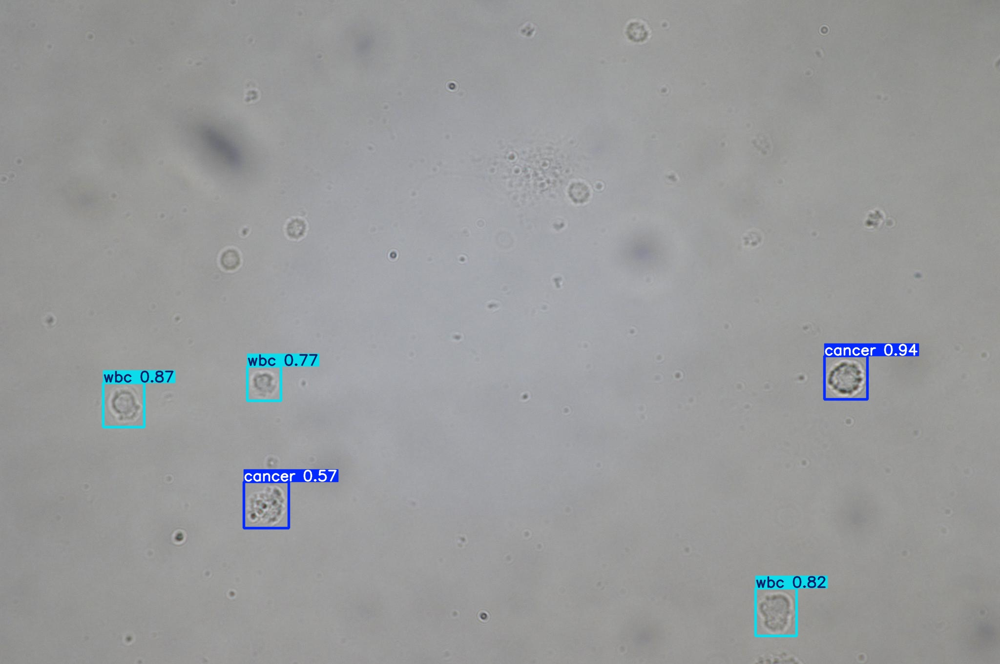

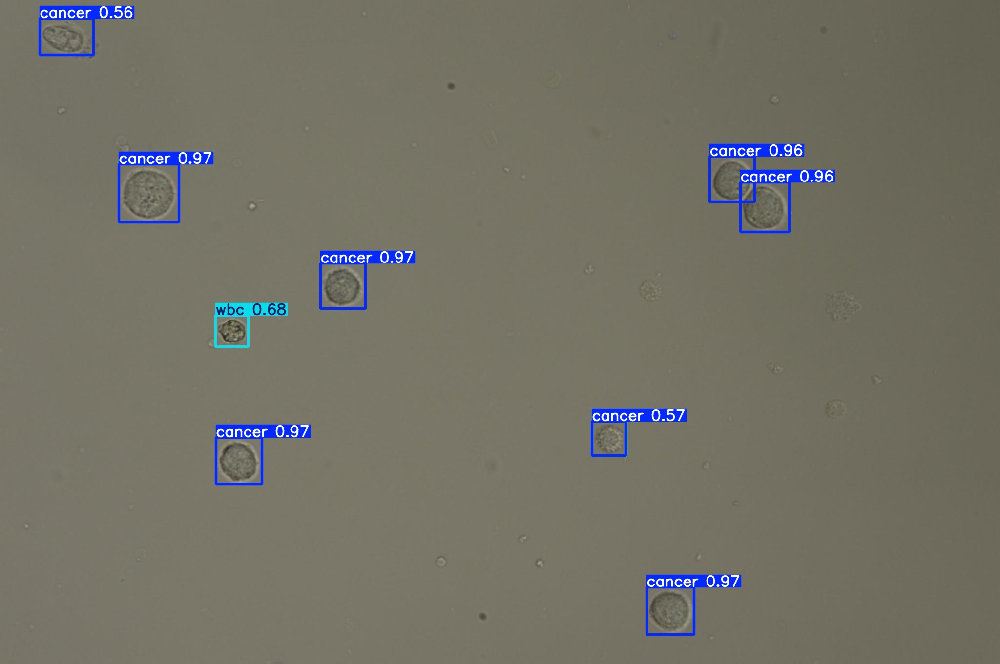

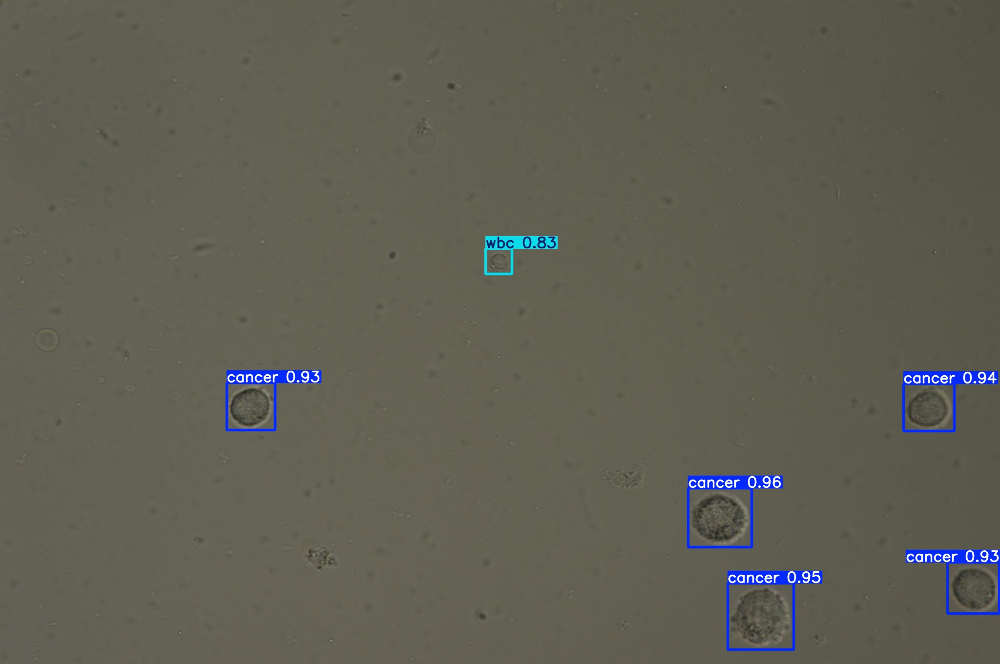

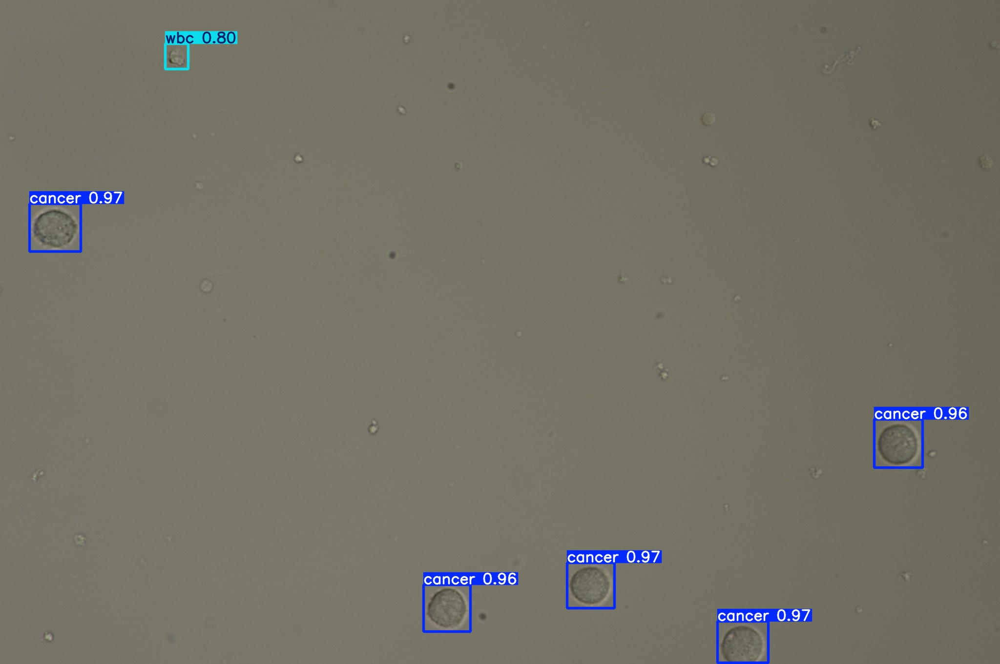

In [ ]:
import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp3/*.jpg')[:10]: #assuming JPG
    display(Image(filename=imageName))

In [ ]:
%cd /content/drive/MyDrive/
!zip -r yolov5s_detection_0407_2.zip /content/yolov5/runs/detect/exp3/

/content/drive/MyDrive
  adding: content/yolov5/runs/detect/exp3/ (stored 0%)
  adding: content/yolov5/runs/detect/exp3/tile_x007_y006_jpg.rf.d317ea10f1638a4fbe8437f5738a4c09.jpg (deflated 5%)
  adding: content/yolov5/runs/detect/exp3/tile_x010_y002_jpg.rf.15461271b19251ee696d93c1ce6b2dc2.jpg (deflated 17%)
  adding: content/yolov5/runs/detect/exp3/tile_x002_y012_jpg.rf.e6f7814177461b7fccc833417f532753.jpg (deflated 10%)
  adding: content/yolov5/runs/detect/exp3/tile_x012_y007_jpg.rf.54b94a4626bfc531006b6f9c05f79d44.jpg (deflated 6%)
  adding: content/yolov5/runs/detect/exp3/tile_x006_y008_jpg.rf.02a143bd17eb03f2570f740610647148.jpg (deflated 9%)
  adding: content/yolov5/runs/detect/exp3/tile_x010_y013_jpg.rf.037e283399305c29071a2357eec20057.jpg (deflated 11%)
  adding: content/yolov5/runs/detect/exp3/tile_x003_y016_jpg.rf.6abb84bb3d6e04b0e490e5b6336d3079.jpg (deflated 15%)
  adding: content/yolov5/runs/detect/exp3/tile_x001_y005_jpg.rf.4d64a7ce1cf7923b44e1002e96d80489.jpg (deflated 18

In [ ]:
from google.colab import files
files.download("yolov5s_detection_0407_2.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>